In [1]:
!pip install torchdiffeq

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, clear_output
import time

from sklearn.datasets import make_swiss_roll
from sklearn.preprocessing import StandardScaler

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.nn.utils import spectral_norm
from torchvision import transforms, datasets
from torchvision.transforms import ToTensor, ToPILImage
from torchdiffeq import odeint_adjoint as odeint
from tqdm import tqdm

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [4]:
dataset = make_swiss_roll(n_samples=5000, noise=0.3, random_state=42)
dataset = StandardScaler().fit_transform(dataset[0])
data = torch.tensor(dataset[:, [0, 2]], dtype=torch.float32).to(device)

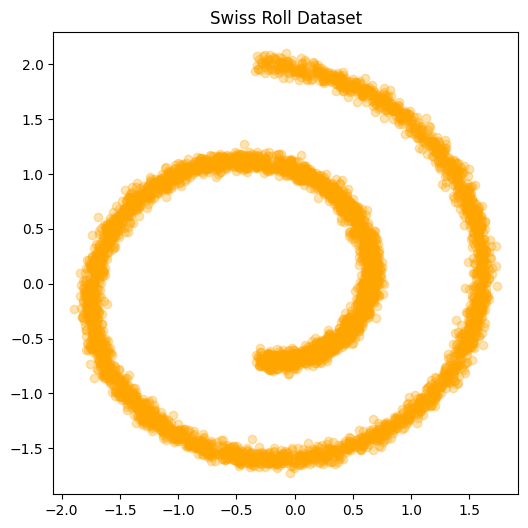

In [5]:
plt.figure(figsize=(6,6))
plt.scatter(data[:,0].cpu(), data[:,1].cpu(), alpha=0.3, c='orange')
plt.title("Swiss Roll Dataset")
plt.show()

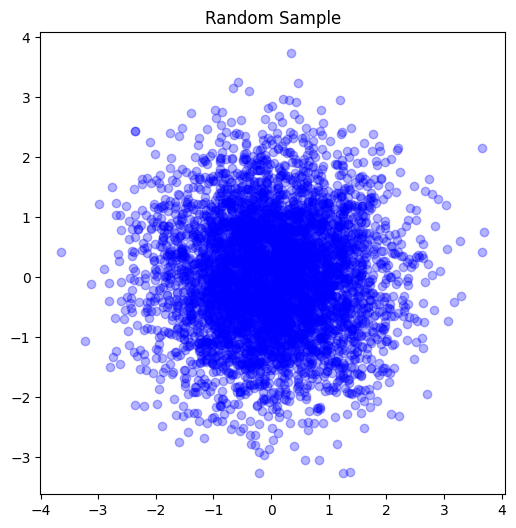

In [6]:
random_sample = torch.randn(5000, 2).to(device)
plt.figure(figsize=(6,6))
plt.scatter(random_sample[:,0].cpu(), random_sample[:,1].cpu(), alpha=0.3, c='blue')
plt.title("Random Sample")
plt.show()

In [12]:
train_loader = torch.utils.data.DataLoader(dataset = data,
                                           batch_size = 256,
                                           shuffle = True)
print(len(train_loader))

20


## FFJORD from Gaussian to Swiss Roll

In [7]:
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super(ODEFunc, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(2 + 1, hidden_dim),
            nn.SiLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.SiLU(),
            nn.Linear(hidden_dim, 2)
        )

    def forward(self, t, x):
        t_vec = torch.ones(x.shape[0], 1).to(x.device) * t
        x_and_t = torch.cat([x, t_vec], dim=1)       
        return self.net(x_and_t)

In [8]:
class FFJORD(nn.Module):
    def __init__(self, odefunc):
        super(FFJORD, self).__init__()
        self.odefunc = odefunc

    def forward(self, t, states):
        # states: [zt, logp_z]
        zt, logp_z = states

        with torch.enable_grad():
            zt.requires_grad_(True)
            dzdt = self.odefunc(t, zt)
            # Compute trace of Jacobian
            epsilon = torch.randn_like(zt)
            grad_z = torch.autograd.grad(dzdt, zt, epsilon, create_graph=True)[0]
            trace = torch.sum(grad_z * epsilon, dim=1)
        dlogp_zdt = -trace.view(-1, 1)
        return dzdt, dlogp_zdt

In [9]:
class ODEModel(nn.Module):
    def __init__(self, odefunc, num_steps=10, dopri=False, rtol=1e-3, atol=1e-3):
        super(ODEModel, self).__init__()
        self.ffjord = FFJORD(odefunc)
        self.num_steps = num_steps
        self.dopri = dopri
        self.rtol = rtol
        self.atol = atol
        
    def forward(self, x):
        batch_size = x.size(0)
        logp_z = torch.zeros(batch_size, 1).to(device)
        if not self.dopri:
            integration_times = torch.linspace(0., 1., steps=self.num_steps).to(device)
            zt, logp_z = odeint(self.ffjord, (x, logp_z), integration_times, method='rk4')
        else:
            zt, logp_z = odeint(self.ffjord, (x, logp_z), torch.tensor([0., 1.]).to(device), rtol=self.rtol, atol=self.atol)

        return zt[-1], logp_z[-1]

In [13]:
def train(model, optimizer, epochs):
    model.train()
    for epoch in range(epochs):
        total_loss = 0
        for batch_idx, batch_data in enumerate(train_loader):
            batch_data = batch_data.to(device)
            batch_size = batch_data.size(0)

            # Forward pass
            z0 = batch_data
            zT, logp_zT = model(z0)

            # Compute log likelihood under standard normal
            logp_z0 = -0.5 * torch.sum(zT**2, dim=1, keepdim=True) - 0.5 * 2 * np.log(2 * np.pi)
            logp_z0 = logp_z0 - logp_zT
            loss = -torch.mean(logp_z0)

            # Backward pass and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        avg_loss = total_loss / len(train_loader)
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {avg_loss:.4f}')
            

In [19]:
model = ODEModel(ODEFunc(hidden_dim=64), num_steps=40).to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
train(model, optimizer, epochs=40)

Epoch [1/40], Loss: 2.8321
Epoch [2/40], Loss: 2.8151
Epoch [3/40], Loss: 2.7939
Epoch [4/40], Loss: 2.7524
Epoch [5/40], Loss: 2.6770
Epoch [6/40], Loss: 2.5762
Epoch [7/40], Loss: 2.4397
Epoch [8/40], Loss: 2.3034
Epoch [9/40], Loss: 2.2525
Epoch [10/40], Loss: 2.2316
Epoch [11/40], Loss: 2.1954
Epoch [12/40], Loss: 2.1810
Epoch [13/40], Loss: 2.1803
Epoch [14/40], Loss: 2.1615
Epoch [15/40], Loss: 2.1523
Epoch [16/40], Loss: 2.1230
Epoch [17/40], Loss: 2.1255
Epoch [18/40], Loss: 2.1209
Epoch [19/40], Loss: 2.1050
Epoch [20/40], Loss: 2.0857
Epoch [21/40], Loss: 2.0837
Epoch [22/40], Loss: 2.0709
Epoch [23/40], Loss: 2.0533
Epoch [24/40], Loss: 2.0508
Epoch [25/40], Loss: 2.0153
Epoch [26/40], Loss: 1.9898
Epoch [27/40], Loss: 1.9832
Epoch [28/40], Loss: 1.9909
Epoch [29/40], Loss: 1.9331
Epoch [30/40], Loss: 1.9181
Epoch [31/40], Loss: 1.8903
Epoch [32/40], Loss: 1.8948
Epoch [33/40], Loss: 1.8651
Epoch [34/40], Loss: 1.8545
Epoch [35/40], Loss: 1.8400
Epoch [36/40], Loss: 1.8157
E

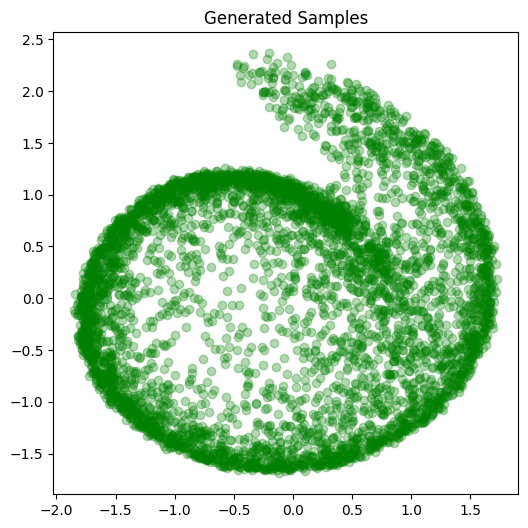

In [20]:
def generate_trajectory(model, num_samples):
    model.eval()
    with torch.no_grad():
        zT = torch.randn(num_samples, 2).to(device)
        logp_zT = torch.zeros(num_samples, 1).to(device)

        if model.dopri:
            integration_times = torch.tensor([1., 0.]).to(device)
            z0, _ = odeint(model.ffjord, (zT, logp_zT), integration_times, rtol=model.rtol, atol=model.atol)
        else:
            integration_times = torch.linspace(1., 0., steps=model.num_steps).to(device)
            z0, _ = odeint(model.ffjord, (zT, logp_zT), integration_times, method='rk4')
        return z0
generated_samples = generate_trajectory(model, 5000)[-1]
plt.figure(figsize=(6,6))
plt.scatter(generated_samples[:,0].cpu(), generated_samples[:,1].cpu(), alpha=0.3, c='green')
plt.title("Generated Samples")
plt.show()

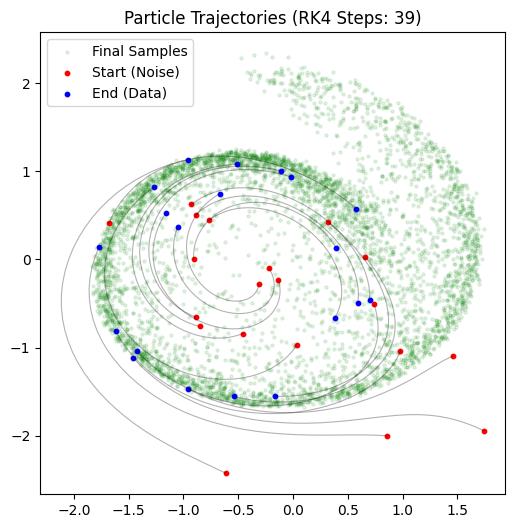

In [26]:
def plot_trajectories(z0, num_plot=100):
    traj = z0.detach().cpu().numpy()
    
    plt.figure(figsize=(6, 6))
    
    final_z = traj[-1]
    plt.scatter(final_z[:, 0], final_z[:, 1], c='green', s=5, alpha=0.1, label='Final Samples')
    
    for i in range(num_plot):
        plt.plot(traj[:, i, 0], traj[:, i, 1], c='black', alpha=0.3, linewidth=0.8)
        
    plt.scatter(traj[0, :num_plot, 0], traj[0, :num_plot, 1], c='red', s=10, label='Start (Noise)')
    plt.scatter(traj[-1, :num_plot, 0], traj[-1, :num_plot, 1], c='blue', s=10, label='End (Data)')

    plt.title(f"Particle Trajectories (RK4 Steps: {traj.shape[0]-1})")
    plt.legend()
    plt.show()

z0_out = generate_trajectory(model, 5000)
plot_trajectories(z0_out, num_plot=20)

Generating GIF...
Displaying ffjord_animation.gif...


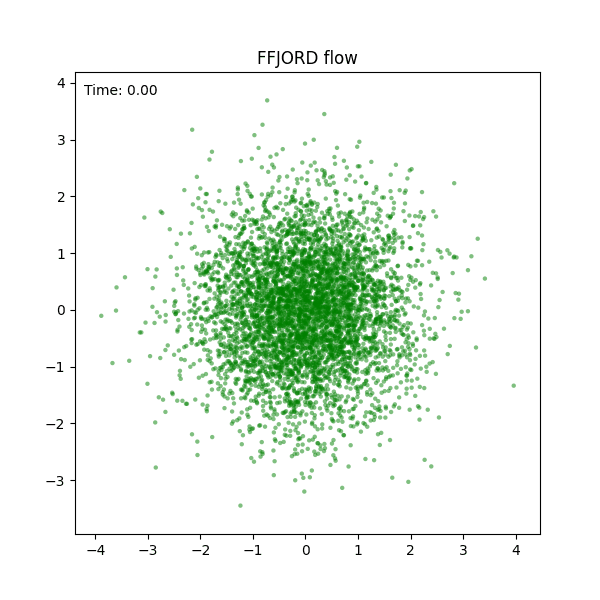

In [ ]:
from matplotlib import animation
from IPython.display import HTML
from IPython.display import Image, display

def show_flow_animation(trajectory, interval=30, title="FFJORD flow", color="green", filename='flow_animation.gif', fps=30):
    if isinstance(trajectory, torch.Tensor):
        trajectory = trajectory.detach().cpu().numpy()
        
    num_frames, _, _ = trajectory.shape
    
    fig, ax = plt.subplots(figsize=(6, 6))
    
    margin = 0.5
    x_min, x_max = trajectory[:, :, 0].min(), trajectory[:, :, 0].max()
    y_min, y_max = trajectory[:, :, 1].min(), trajectory[:, :, 1].max()
    
    ax.set_xlim(x_min - margin, x_max + margin)
    ax.set_ylim(y_min - margin, y_max + margin)
    ax.set_title(title)
    
    scatter = ax.scatter([], [], s=10, alpha=0.5, c=color, edgecolors='none')
    text = ax.text(0.02, 0.95, '', transform=ax.transAxes) 

    def update(frame):
        current_points = trajectory[frame]
        scatter.set_offsets(current_points)
        
        t = frame / (num_frames - 1)
        text.set_text(f"Time: {t:.2f}")
        return scatter, text

    anim = animation.FuncAnimation(
        fig, update, frames=num_frames, interval=interval, blit=True, repeat=True
    )

    print("Generating GIF...")
    anim.save(filename, writer='pillow', fps=fps)
    plt.close() 
    
    print(f"Displaying {filename}...")
    display(Image(filename=filename))
    
    return anim

z_traj = generate_trajectory(model, 5000)
anim = show_flow_animation(z_traj, filename="ffjord_animation.gif")
HTML(anim.to_jshtml())

## Rectified Flow Matching
Reflow from FFJORD model

In [52]:
# Create trajectory matching dataset
from tqdm import tqdm
model.eval()
model.requires_grad_(False)

z0s = []
z1s = []

batch_size = 512
num_batches = 200

num_samples = batch_size * num_batches

with torch.no_grad():
    for _ in tqdm(range(num_batches)):
        z0 = torch.randn(batch_size, 2).to(device)
        
        logp_z1 = torch.zeros(batch_size, 1).to(device)

        if model.dopri:
            integration_times = torch.tensor([1., 0.]).to(device)
            z1, _ = odeint(model.ffjord, (z0, logp_z1), integration_times, rtol=model.rtol, atol=model.atol)
        else:
            integration_times = torch.linspace(1., 0., steps=model.num_steps).to(device)
            z1, _ = odeint(model.ffjord, (z0, logp_z1), integration_times, method='rk4')
        
        z1 = z1[-1]
        z0s.append(z0.cpu())
        z1s.append(z1.cpu())

Z0 =  torch.cat(z0s, dim=0)
Z1 =  torch.cat(z1s, dim=0)

print(f"Trajectory matching dataset created: {Z0.shape}, {Z1.shape}")

100%|██████████| 200/200 [00:38<00:00,  5.16it/s]

Trajectory matching dataset created: torch.Size([102400, 2]), torch.Size([102400, 2])


In [53]:
def train_reflow(model, optimizer, epochs):
    model.train()
    dataset_size = Z0.size(0)
    for epoch in range(epochs):
        perm = torch.randperm(dataset_size)
        total_loss = 0
        for i in range(0, dataset_size, batch_size):
            indices = perm[i:i+batch_size]
            batch_z0 = Z0[indices].to(device)
            batch_z1 = Z1[indices].to(device)

            t = torch.rand(batch_z0.size(0), 1).to(device)
            batch_zt = t * batch_z1 + (1 - t) * batch_z0
            pred_zt = model(t, batch_zt)
            loss = F.mse_loss(pred_zt, batch_z1 - batch_z0)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        avg_loss = total_loss / (dataset_size / batch_size)
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {avg_loss:.6f}')

In [54]:
student = ODEFunc(hidden_dim=64).to(device)
student_optimizer = optim.Adam(student.parameters(), lr=1e-3)
train_reflow(student, student_optimizer, epochs=100)

Epoch [1/100], Loss: 1.392675
Epoch [2/100], Loss: 0.578715
Epoch [3/100], Loss: 0.463494
Epoch [4/100], Loss: 0.415592
Epoch [5/100], Loss: 0.367181
Epoch [6/100], Loss: 0.319990
Epoch [7/100], Loss: 0.284499
Epoch [8/100], Loss: 0.258360
Epoch [9/100], Loss: 0.241974
Epoch [10/100], Loss: 0.225831
Epoch [11/100], Loss: 0.215525
Epoch [12/100], Loss: 0.210704
Epoch [13/100], Loss: 0.201275
Epoch [14/100], Loss: 0.196413
Epoch [15/100], Loss: 0.190768
Epoch [16/100], Loss: 0.187551
Epoch [17/100], Loss: 0.182567
Epoch [18/100], Loss: 0.179663
Epoch [19/100], Loss: 0.176228
Epoch [20/100], Loss: 0.172738
Epoch [21/100], Loss: 0.171029
Epoch [22/100], Loss: 0.168372
Epoch [23/100], Loss: 0.166425
Epoch [24/100], Loss: 0.161840
Epoch [25/100], Loss: 0.163038
Epoch [26/100], Loss: 0.161191
Epoch [27/100], Loss: 0.159761
Epoch [28/100], Loss: 0.157070
Epoch [29/100], Loss: 0.157385
Epoch [30/100], Loss: 0.156133
Epoch [31/100], Loss: 0.156288
Epoch [32/100], Loss: 0.154348
Epoch [33/100], L

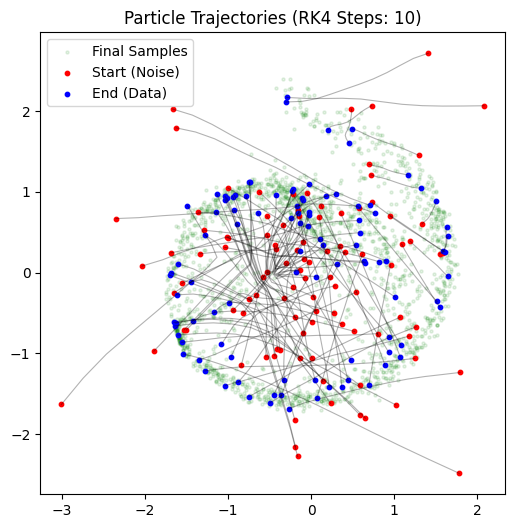

In [62]:
student.eval()
with torch.no_grad():
    z0 = torch.randn(2000, 2).to(device)
    
    times = torch.linspace(0., 1., steps=11).to(device)
    z_traj = odeint(student, z0, times, method='rk4')
    z_final_rk4 = z_traj[-1]

    plot_trajectories(z_traj)

Generating GIF...
Displaying reflow_animation.gif...


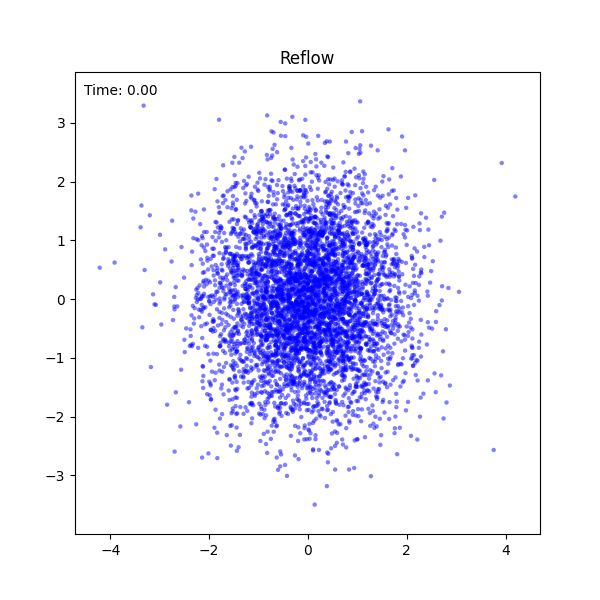

In [107]:
z0 = torch.randn(5000, 2).to(device)
    
times = torch.linspace(0., 1., steps=40).to(device)
z_traj = odeint(student, z0, times, method='rk4')

anim = show_flow_animation(z_traj, color="blue", title="Reflow", filename="reflow_animation.gif")
HTML(anim.to_jshtml())

## Reflow Again
Toward Straightforward

In [64]:
student.eval()
student.requires_grad_(False)

z0s_r = []
z1s_r = []

batch_size = 512
num_batches = 200

num_samples = batch_size * num_batches

with torch.no_grad():
    for _ in tqdm(range(num_batches)):
        z0 = torch.randn(batch_size, 2).to(device)
        times = torch.linspace(0., 1., steps=20).to(device)
        z_traj = odeint(student, z0, times, method='rk4')
        
        z1 = z_traj[-1]
        z0s_r.append(z0.cpu())
        z1s_r.append(z1.cpu())

Z0_r =  torch.cat(z0s_r, dim=0)
Z1_r =  torch.cat(z1s_r, dim=0)

print(f"Trajectory matching dataset created: {Z0_r.shape}, {Z1_r.shape}")

100%|██████████| 200/200 [00:06<00:00, 30.77it/s]

Trajectory matching dataset created: torch.Size([102400, 2]), torch.Size([102400, 2])


In [66]:
def train_rereflow(model, optimizer, epochs):
    model.train()
    dataset_size = Z0_r.size(0)
    for epoch in range(epochs):
        perm = torch.randperm(dataset_size)
        total_loss = 0
        for i in range(0, dataset_size, batch_size):
            indices = perm[i:i+batch_size]
            batch_z0 = Z0_r[indices].to(device)
            batch_z1 = Z1_r[indices].to(device)

            t = torch.rand(batch_z0.size(0), 1).to(device)
            batch_zt = t * batch_z1 + (1 - t) * batch_z0
            pred_zt = model(t, batch_zt)
            loss = F.mse_loss(pred_zt, batch_z1 - batch_z0)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        avg_loss = total_loss / (dataset_size / batch_size)
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {avg_loss:.6f}')

In [67]:
student_r = ODEFunc(hidden_dim=64).to(device)
student_optimizer_r = optim.Adam(student_r.parameters(), lr=1e-3)
train_rereflow(student_r, student_optimizer_r, epochs=100)

Epoch [1/100], Loss: 0.981550
Epoch [2/100], Loss: 0.402493
Epoch [3/100], Loss: 0.299338
Epoch [4/100], Loss: 0.254113
Epoch [5/100], Loss: 0.207847
Epoch [6/100], Loss: 0.168123
Epoch [7/100], Loss: 0.145006
Epoch [8/100], Loss: 0.129821
Epoch [9/100], Loss: 0.118752
Epoch [10/100], Loss: 0.110844
Epoch [11/100], Loss: 0.103742
Epoch [12/100], Loss: 0.098675
Epoch [13/100], Loss: 0.094345
Epoch [14/100], Loss: 0.089887
Epoch [15/100], Loss: 0.085743
Epoch [16/100], Loss: 0.083272
Epoch [17/100], Loss: 0.081253
Epoch [18/100], Loss: 0.078981
Epoch [19/100], Loss: 0.077319
Epoch [20/100], Loss: 0.075220
Epoch [21/100], Loss: 0.074388
Epoch [22/100], Loss: 0.073014
Epoch [23/100], Loss: 0.071580
Epoch [24/100], Loss: 0.070397
Epoch [25/100], Loss: 0.069897
Epoch [26/100], Loss: 0.068319
Epoch [27/100], Loss: 0.067949
Epoch [28/100], Loss: 0.067128
Epoch [29/100], Loss: 0.066769
Epoch [30/100], Loss: 0.066504
Epoch [31/100], Loss: 0.064544
Epoch [32/100], Loss: 0.063247
Epoch [33/100], L

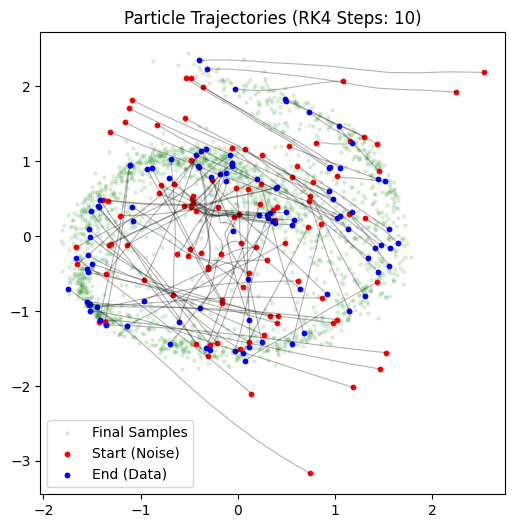

In [94]:
student_r.eval()
with torch.no_grad():
    z0 = torch.randn(2000, 2).to(device)
    
    times = torch.linspace(0., 1., steps=11).to(device)
    z_traj = odeint(student_r, z0, times, method='rk4')
    z_final_rk4 = z_traj[-1]

    plot_trajectories(z_traj)

Generating GIF...
Displaying rereflow_animation.gif...


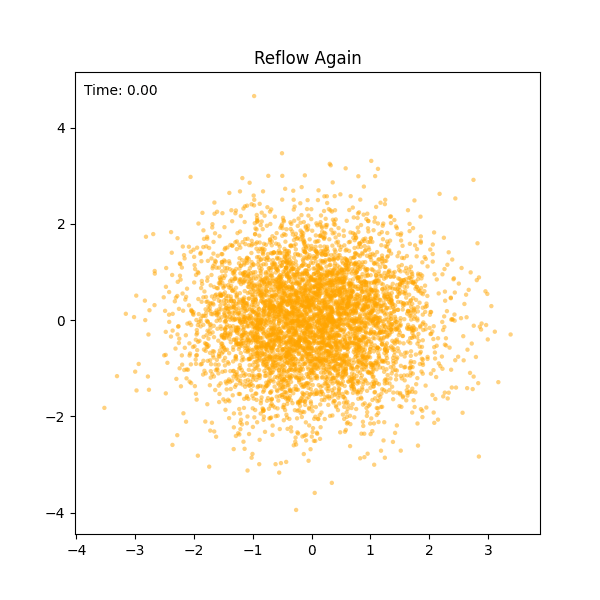

In [109]:
z0 = torch.randn(5000, 2).to(device)
    
times = torch.linspace(0., 1., steps=40).to(device)
z_traj = odeint(student_r, z0, times, method='rk4')

anim = show_flow_animation(z_traj, color="orange", title="Reflow Again", filename="rereflow_animation.gif")
HTML(anim.to_jshtml())

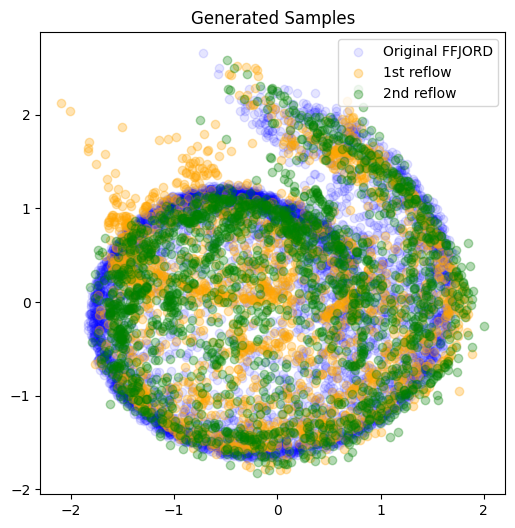

In [93]:
z0 = torch.randn(2000, 2).to(device)
times = torch.linspace(0., 1., steps=2).to(device)
z_traj = odeint(student_r, z0, times, method='rk4')
generated_samples = z_traj[-1].detach()

z_traj_o = odeint(student, z0, times, method='rk4')
generated_samples_o = z_traj_o[-1].detach()

plt.figure(figsize=(6,6))

generated_samples_f = generate_trajectory(model, 5000)[-1]
plt.scatter(generated_samples_f[:,0].cpu(), generated_samples_f[:,1].cpu(), alpha=0.1, c='blue', label='Original FFJORD')
plt.scatter(generated_samples_o[:,0].cpu(), generated_samples_o[:,1].cpu(), alpha=0.3, c='orange', label='1st reflow')
plt.scatter(generated_samples[:,0].cpu(), generated_samples[:,1].cpu(), alpha=0.3, c='green', label='2nd reflow')
plt.title("Generated Samples")
plt.legend()
plt.show()